In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
plotly.offline.init_notebook_mode()
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.graph_objs as go
import plotly.express as px


In [2]:
#data_ = pd.read_csv('data/data_.csv') 
#data_ajustada = pd.read_csv('data/data_ajustada.csv')
data_investment_poberty_dr = pd.read_csv('data/data_investment_poberty_dr.csv')
data_bonus = pd.read_csv('data/data_bonus.csv')
data_abs_mean = pd.read_csv('data/data_abs_mean.csv')
data_total_mean = pd.read_csv('data/data_total_mean.csv')

# 'data_total_mean' , 'data_bonus', 'data_investment_poberty_dr' incluyen 2007-2018
# los otros df incluyen desde el año 2000 pero sin columnas de renta, pobreza, inversión y médicos

In [3]:
muertes_totales = data_total_mean.groupby('Comunidad Autónoma').sum()[
                                        'Todas las causas'].sort_values(ascending = False)

muertes_totales

trace1 = {
    'x':muertes_totales.index,
    'y': muertes_totales.values,
    'name': 'Decesos totales en España',
    'type': 'bar'
}

data=[trace1]

layout = {
    'title': '¿Dónde fallecen más españoles con respecto a su población?\n2007 - 2018'
}
fig = go.Figure(data=data, layout=layout)
fig.update_xaxes(tickangle=30)
iplot(fig)

In [5]:
muertes_totales_tumores = data_total_mean.groupby('Comunidad Autónoma').sum()['Tumores'].sort_values(ascending = False)

trace1 = {
    'x':muertes_totales_tumores.index,
    'y': muertes_totales_tumores.values,
    'name': 'Decesos totales por tumores en España',
    'type': 'bar'
}

data=[trace1]

layout = {
    'title': '¿Dónde fallecen más españoles por tumores?'
}
fig = go.Figure(data=data, layout=layout)
fig.update_xaxes(tickangle=30)
iplot(fig)

In [6]:
data_melted = data_investment_poberty_dr.copy()

data_melted = pd.melt(data_melted, id_vars=['Comunidad Autónoma', 'Año', 'Población', 'Renta', 'Tasa pobreza',
                                   'Médicos especialistas'],
        
                            value_vars=['Todas las causas','Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

data_melted.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

# filtro para coger sólo el valor NACIONAL ya que agrupa los valores totales
data_melted = data_melted[data_melted['Comunidad Autónoma'] == 'NACIONAL']
data_melted

,Comunidad Autónoma,Año,Población,Renta,Tasa pobreza,Médicos especialistas,Enfermedades,Muertes
0,NACIONAL,2018,46729000,25727,21.5,1.98,Todas las causas,427721.0
18,NACIONAL,2017,46532000,24969,21.6,1.93,Todas las causas,424523.0
36,NACIONAL,2016,46449000,23979,22.3,1.90,Todas las causas,410611.0
54,NACIONAL,2015,46410000,23219,22.1,1.85,Todas las causas,422568.0
72,NACIONAL,2014,46455000,22218,22.2,1.81,Todas las causas,395830.0
...,...,...,...,...,...,...,...,...
3798,NACIONAL,2011,46736000,22761,20.6,1.81,Causas externas,14233.0
3816,NACIONAL,2010,46562000,23038,20.7,1.79,Causas externas,14066.0
3834,NACIONAL,2009,46367000,23062,20.4,1.81,Causas externas,14496.0
3852,NACIONAL,2008,45983000,24129,20.8,1.76,Causas externas,15289.0


In [7]:
enf_muertes = data_melted.groupby('Enfermedades', as_index = True).sum()['Muertes'].sort_values(ascending = True)

# quiero todas las enfermedades, pero no 'Todas las causas'
enf_muertes = enf_muertes[enf_muertes.index != 'Todas las causas']
enf_muertes

Enfermedades
Embarazo, parto y puerperio                     175.0
Afecciones periodo perinatal                   9367.0
Anomalías congénitas y cromosómicas           10308.0
Enfermedades de la piel                       16424.0
Enfermedades de la sangre                     19957.0
Enfermedades del sistema osteomuscular        46448.0
Enfermedades infecciosas y parasitarias       82278.0
Síntomas no clasificados                     119732.0
Enfermedades del sistema genitourinario      139632.0
Enfermedades endocrinas                      153992.0
Causas externas                              179937.0
Trastornos mentales y del comportamiento     209142.0
Enfermedades del sistema digestivo           238508.0
Enfermedades del sistema nervioso            263202.0
Enfermedades del sistema respiratorio        551724.0
Tumores                                     1311668.0
Enfermedades del sistema circulatorio       1448704.0
Name: Muertes, dtype: float64

Text(0, 0.5, 'Enfermedades')

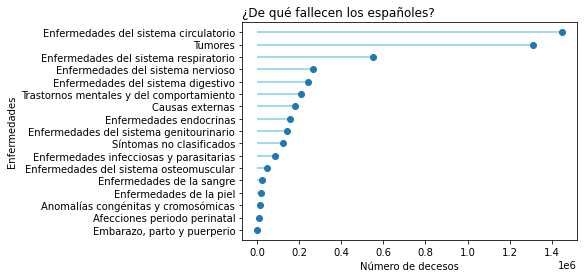

In [8]:
# Reorder it following the values:
my_range=range(1,len(enf_muertes.index)+1)
 
# The vertival plot is made using the hline function
plt.hlines(y=my_range, xmin=0, xmax=enf_muertes.values, color='skyblue')
plt.plot(enf_muertes.values, my_range, "o")
 
# Add titles and axis names
plt.yticks(my_range, enf_muertes.index)
plt.title("¿De qué fallecen los españoles?", loc='left')
plt.xlabel('Número de decesos')
plt.ylabel('Enfermedades')


Text(0, 0.5, 'Enfermedades')

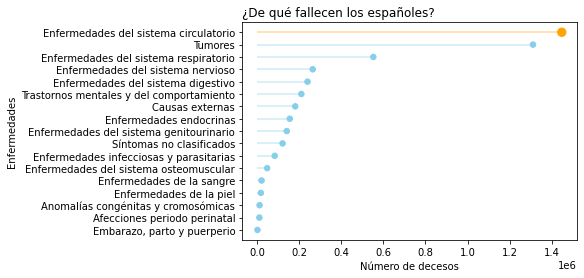

In [8]:
# Create a color if the disease is "sistema circulatorio"
my_color=np.where(enf_muertes.index =='Enfermedades del sistema circulatorio', 'orange', 'skyblue')
my_size=np.where(enf_muertes.index =='Enfermedades del sistema circulatorio', 70, 30)

# Reorder it following the values:
my_range=range(1,len(enf_muertes.index)+1)

plt.hlines(y=my_range, xmin=0, xmax=enf_muertes.values, color=my_color, alpha=0.4)
plt.scatter(enf_muertes.values, my_range, color=my_color, s=my_size, alpha=1)

 
# Add titles and axis names
plt.yticks(my_range, enf_muertes.index)
plt.title("¿De qué fallecen los españoles?", loc='left')
plt.xlabel('Número de decesos')
plt.ylabel('Enfermedades')


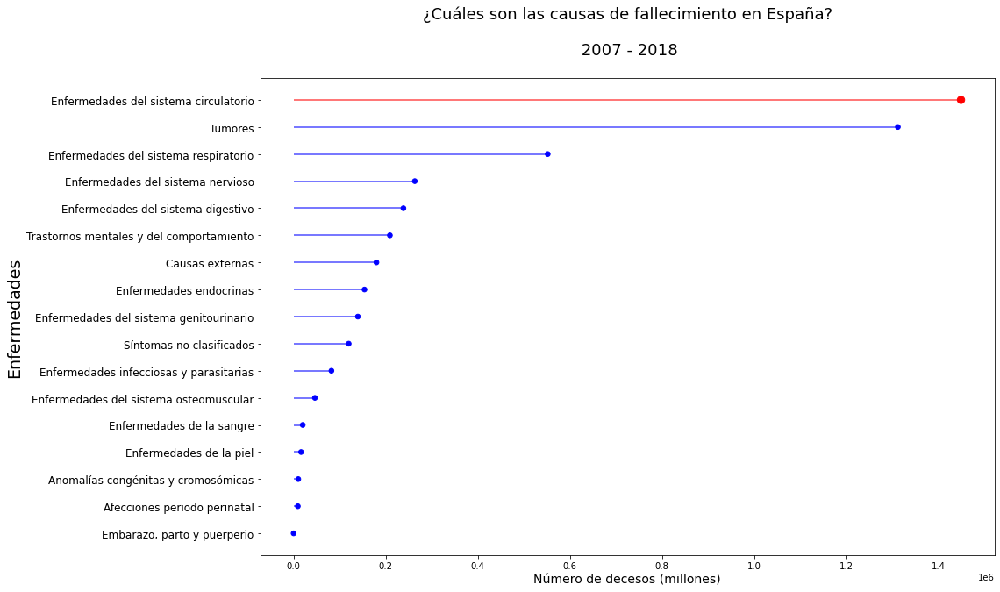

In [9]:
plt.figure(figsize = (15,10))


# Create a color if the group is "sistema circulatorio"
my_color=np.where(enf_muertes.index =='Enfermedades del sistema circulatorio', 'red', 'blue')
my_size=np.where(enf_muertes.index =='Enfermedades del sistema circulatorio', 70, 30)

# Reorder it following the values:
my_range=range(1,len(enf_muertes.index)+1)

plt.hlines(y=my_range, xmin=0, xmax=enf_muertes.values, color=my_color, alpha=0.7)
plt.scatter(enf_muertes.values, my_range, color=my_color, s=my_size, alpha=1)

 
# Add titles and axis names
plt.yticks(my_range, enf_muertes.index, size = 12)
plt.title("¿Cuáles son las causas de fallecimiento en España?\n\n 2007 - 2018\n", size = 18, loc='center')
plt.xlabel('Número de decesos (millones)', size = 14)
plt.ylabel('Enfermedades', size = 19)


plt.savefig('ranking_enfermedades.png', dpi=400, bbox_inches="tight")


In [3]:
# VOY A COMPARAR 2007 y 2018


data_loli2 = data_investment_poberty_dr.copy()
data_loli2 = data_loli2[(data_loli2['Año'] == 2007) & 
                        (data_loli2['Comunidad Autónoma'] == 'NACIONAL')]

data_loli2 


,ID,Comunidad Autónoma,Año,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
198,0,NACIONAL,2007,385361.0,7782.0,103329.0,1289.0,12237.0,12310.0,16723.0,...,13.0,969.0,890.0,11358.0,15916.0,45236000,23776,1172.200705,19.7,1.7


In [4]:
data_loli2_melted = data_loli2.copy()

data_loli2_melted = pd.melt(data_loli2_melted, id_vars=['Comunidad Autónoma', 'Año', 'Población', 'Renta', 'Tasa pobreza',
                                   'Médicos especialistas'],
        
                            value_vars=['Todas las causas','Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

data_loli2_melted.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

data_loli2_melted = data_loli2_melted[data_loli2_melted['Enfermedades'] != 'Todas las causas']

data_loli2_melted = data_loli2_melted.groupby('Enfermedades', 
                                              as_index = True).sum()['Muertes'].sort_values(ascending = True)

data_loli2_melted

Enfermedades
Embarazo, parto y puerperio                     13.0
Anomalías congénitas y cromosómicas            890.0
Afecciones periodo perinatal                   969.0
Enfermedades de la piel                       1186.0
Enfermedades de la sangre                     1289.0
Enfermedades del sistema osteomuscular        3384.0
Enfermedades infecciosas y parasitarias       7782.0
Enfermedades del sistema genitourinario      10170.0
Síntomas no clasificados                     11358.0
Enfermedades endocrinas                      12237.0
Trastornos mentales y del comportamiento     12310.0
Causas externas                              15916.0
Enfermedades del sistema nervioso            16723.0
Enfermedades del sistema digestivo           19650.0
Enfermedades del sistema respiratorio        44029.0
Tumores                                     103329.0
Enfermedades del sistema circulatorio       124126.0
Name: Muertes, dtype: float64

In [5]:
# para 2018

data_loli3 = data_investment_poberty_dr.copy()
data_loli3 = data_loli3[(data_loli3['Año'] == 2018) & 
                        (data_loli3['Comunidad Autónoma'] == 'NACIONAL')]

data_loli3_melted = data_loli3.copy()

data_loli3_melted = pd.melt(data_loli3_melted, id_vars=['Comunidad Autónoma', 'Año', 'Población', 'Renta', 
                                                        'Tasa pobreza', 'Médicos especialistas'],
        
                            value_vars=['Todas las causas','Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

data_loli3_melted.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

data_loli3_melted = data_loli3_melted[data_loli3_melted['Enfermedades'] != 'Todas las causas']

data_loli3_melted = data_loli3_melted.groupby('Enfermedades', 
                                              as_index = True).sum()['Muertes'].sort_values(ascending = True)

data_loli3_melted

Enfermedades
Embarazo, parto y puerperio                      7.0
Afecciones periodo perinatal                   630.0
Anomalías congénitas y cromosómicas            843.0
Enfermedades de la piel                       1826.0
Enfermedades de la sangre                     1946.0
Enfermedades del sistema osteomuscular        5205.0
Enfermedades infecciosas y parasitarias       6398.0
Síntomas no clasificados                     10088.0
Enfermedades endocrinas                      13465.0
Enfermedades del sistema genitourinario      13941.0
Causas externas                              15768.0
Enfermedades del sistema digestivo           21689.0
Trastornos mentales y del comportamiento     22376.0
Enfermedades del sistema nervioso            26279.0
Enfermedades del sistema respiratorio        53687.0
Tumores                                     112714.0
Enfermedades del sistema circulatorio       120859.0
Name: Muertes, dtype: float64

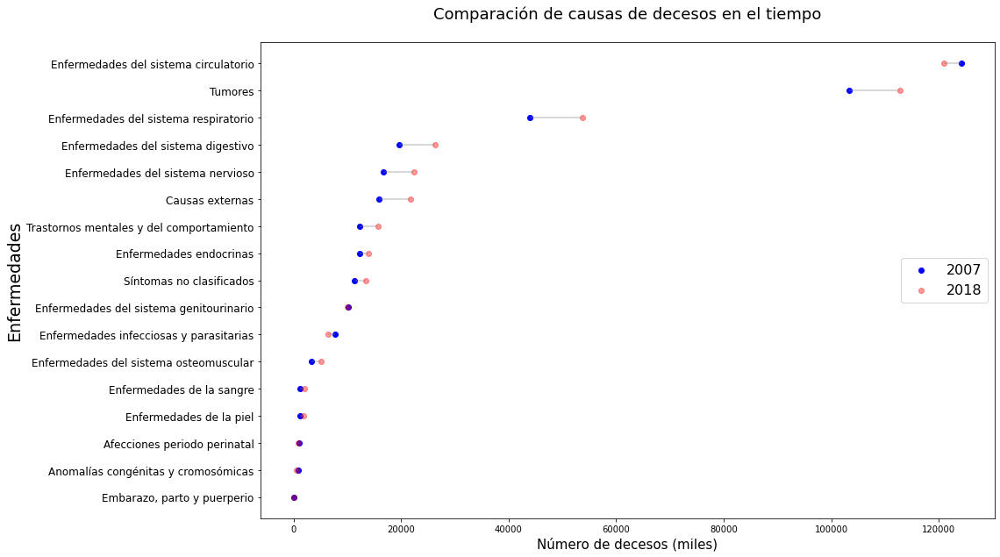

In [6]:
plt.figure(figsize = (15,10))


my_range=range(1,len(data_loli3_melted.index)+1)
 
# The vertical plot is made using the hline function
plt.hlines(y=my_range, xmin=data_loli3_melted.values, xmax=data_loli2_melted.values, color='grey', alpha=0.4)
plt.scatter(data_loli2_melted.values, my_range, color='blue', alpha=1, label='2007')
plt.scatter(data_loli3_melted.values, my_range, color='red', alpha=0.4 , label='2018')
plt.legend(loc = 'center right', prop={'size': 16})
 
# Add title and axis names
plt.yticks(my_range, data_loli2_melted.index, size = 12)
plt.title("Comparación de causas de decesos en el tiempo\n", size = 18, loc='center')
plt.xlabel('Número de decesos (miles)', size = 15)
plt.ylabel('Enfermedades', size = 19)

plt.savefig('ranking_enfermedades_tiempo.png', dpi=400, bbox_inches="tight")


-----------

In [14]:
# voy a pintar la evolución de las enfermedades en el tiempo y ver cómo se comportan unas con respecto a otras
# he dejado fuera 'Causas externas' ya que no se trata de enfermedades

enf_vs_enf = data_investment_poberty_dr.copy()


# agrupo por 'Año' porque es la variable que irá en el 'eje x'
enf_vs_enf = enf_vs_enf.groupby('Año').sum().loc[
            :,'Enfermedades infecciosas y parasitarias' : 'Síntomas no clasificados']

enf_vs_enf.reset_index(drop = False, inplace = True)

enf_vs_enf

,Año,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,Enfermedades del sistema circulatorio,Enfermedades del sistema respiratorio,Enfermedades del sistema digestivo,Enfermedades de la piel,Enfermedades del sistema osteomuscular,Enfermedades del sistema genitourinario,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados
0,2007,15480.0,206206.0,2564.0,24399.0,24590.0,33381.0,247086.0,87837.0,39138.0,2365.0,6753.0,20271.0,26.0,1922.0,1763.0,22528.0
1,2008,15335.0,207630.0,2669.0,24607.0,26050.0,34930.0,244397.0,88147.0,38799.0,2417.0,6788.0,21110.0,48.0,1869.0,1832.0,22841.0
2,2009,13623.0,209843.0,2920.0,24828.0,28888.0,37498.0,239133.0,86348.0,38967.0,2391.0,6905.0,21648.0,34.0,1776.0,1757.0,21994.0
3,2010,12904.0,214020.0,3030.0,25098.0,29608.0,38512.0,237214.0,80277.0,38067.0,2283.0,6640.0,20924.0,39.0,1647.0,1925.0,21368.0
4,2011,12725.0,218261.0,3040.0,25493.0,30525.0,40443.0,235539.0,84245.0,39006.0,2334.0,6759.0,21960.0,28.0,1649.0,1821.0,21029.0
5,2012,12974.0,221572.0,3094.0,25555.0,34277.0,44117.0,243086.0,94435.0,39441.0,2603.0,7508.0,23634.0,19.0,1645.0,1632.0,19878.0
6,2013,12362.0,221579.0,3268.0,24325.0,33918.0,42892.0,233862.0,84912.0,38607.0,2573.0,6706.0,23322.0,36.0,1416.0,1496.0,17759.0
7,2014,12937.0,220053.0,3549.0,25941.0,37392.0,46717.0,233526.0,87440.0,38584.0,2629.0,7340.0,23012.0,18.0,1527.0,1637.0,16843.0
8,2015,15047.0,222308.0,4040.0,28040.0,42624.0,51568.0,247162.0,103425.0,40539.0,3116.0,8270.0,24286.0,29.0,1328.0,1581.0,18833.0
9,2016,13986.0,225325.0,3752.0,25302.0,41918.0,50379.0,238212.0,93336.0,39993.0,3041.0,8490.0,24293.0,29.0,1258.0,1675.0,15932.0


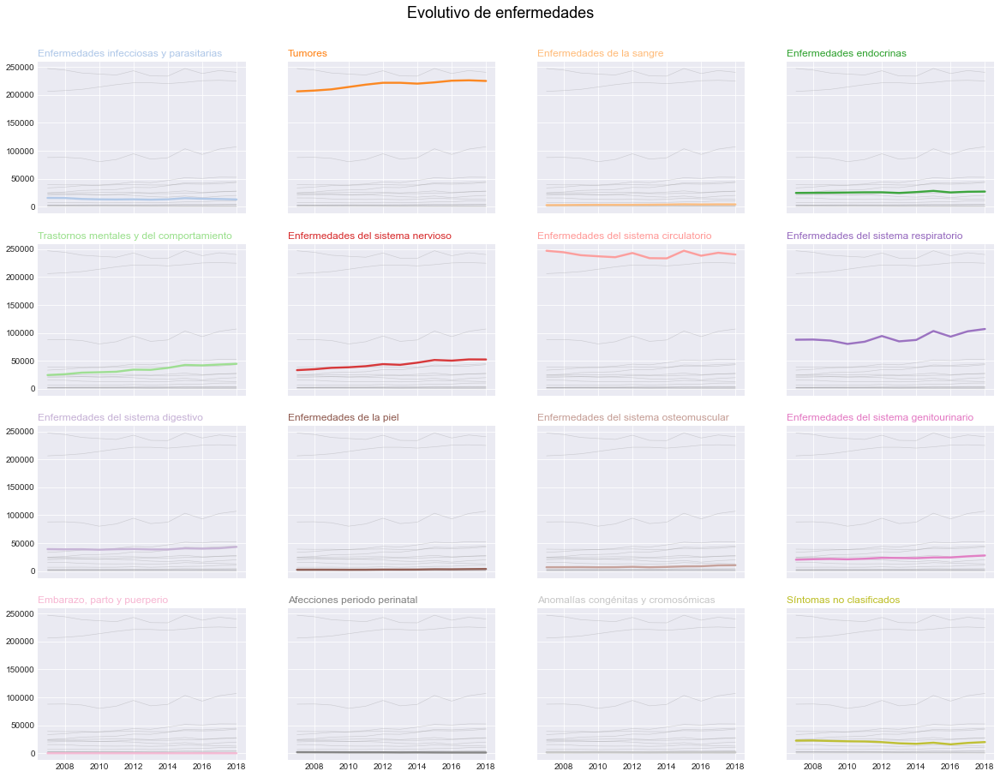

In [15]:

plt.figure(figsize = (20,15))

# Initialize the figure
plt.style.use('seaborn-darkgrid')
 
# create a color palette
palette = plt.get_cmap('tab20')
 
# multiple line plot
num=0
for column in enf_vs_enf.drop('Año', axis=1):
    num+=1
 
    # Find the right spot on the plot
    plt.subplot(4,4, num)
 
    # plot every groups, but discreet
    for v in enf_vs_enf.drop('Año', axis=1):
        plt.plot(enf_vs_enf['Año'], enf_vs_enf[v], marker='', color='grey', linewidth=0.6, alpha=0.3)
 
    # Plot the lineplot
    plt.plot(enf_vs_enf['Año'], enf_vs_enf[column], marker='', color=palette(num), 
             linewidth=2.4, alpha=0.9, label=column)
 
    if num in [1, 2,3,4,5,6,7,8,9,10,11,12]:
        #plt.tick_params(labelbottom='off')
        plt.tick_params(
        axis='x',          
        which='both',      
        bottom=False,      
        top=False,         
        labelbottom=False)

    if num not in [1,5,9, 13]:
        #plt.tick_params(labelleft='off')
        plt.tick_params(
        axis='y',          
        which='both',      
        left = False,         
        labelleft=False)

 
    # Add title
    plt.title(column, loc='left', fontsize=12, fontweight=0, color=palette(num) )
 
# general title
plt.suptitle("Evolutivo de enfermedades", fontsize=18, fontweight=0, color='black', y=0.94);



# Axis title
#plt.text(-7, -8.0, 'Año', ha='center', fontsize = 25, va='center')
#plt.text(-26.09, 39.9, 'Número de decesos', ha='center', va='center', fontsize = 25, rotation='vertical')

# cuando le añado este último apartado no me lo pinta

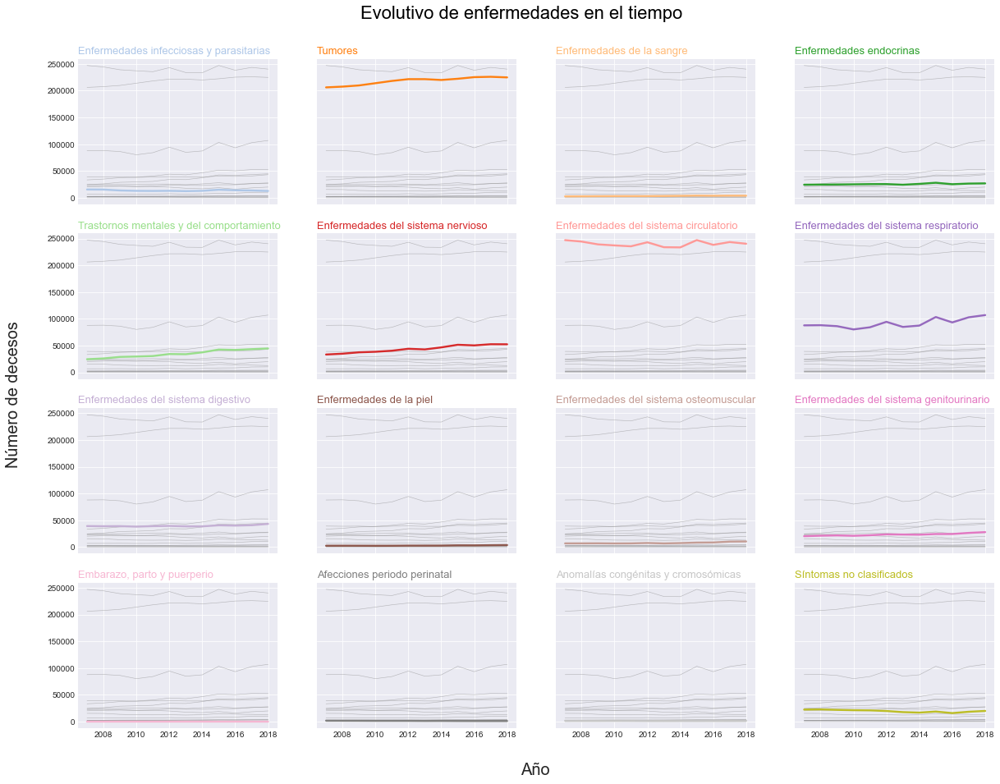

In [16]:
###############

# Voy a intentar meterle título a eje 'x' e 'y' de otro modo

fig = plt.figure(figsize = (20,15))
ax = fig.add_subplot(111)   


# Initialize the figure
plt.style.use('seaborn-darkgrid')
 
# create a color palette
palette = plt.get_cmap('tab20')
 
# multiple line plot
num=0
for column in enf_vs_enf.drop('Año', axis=1):
    num+=1
 
    # Find the right spot on the plot
    plt.subplot(4,4, num)
 
    # plot every groups, but discreet
    for v in enf_vs_enf.drop('Año', axis=1):
        plt.plot(enf_vs_enf['Año'], enf_vs_enf[v], marker='', color='grey', linewidth=0.6, alpha=0.5)
 
    # Plot the lineplot
    plt.plot(enf_vs_enf['Año'], enf_vs_enf[column], marker='', color=palette(num), 
             linewidth=2.4, alpha=0.98, label=column)
 
    if num in [1, 2,3,4,5,6,7,8,9,10,11,12]:
        #plt.tick_params(labelbottom='off')
        plt.tick_params(
        axis='x',            
        labelbottom=False)

    if num not in [1,5,9, 13]:
        #plt.tick_params(labelleft='off')
        plt.tick_params(
        axis='y',              
        labelleft=False)
        
 
    # Add title
    plt.title(column, loc='left', fontsize=13, fontweight=4, color=palette(num) )
 
# general title
plt.suptitle("Evolutivo de enfermedades en el tiempo", fontsize=22, fontweight=0, color='black', y=0.94);


## adding titles to 'x' and 'y' axis

ax = plt.gca()

# sets axes labels on both ends
ax.annotate('Año', xy=(-1.38, -0.32), xycoords='axes fraction', fontsize=20)
ax.annotate('Número de decesos', xy=(-3.9, 1.8), xytext=(-15,2), xycoords='axes fraction', 
            textcoords='offset points', fontsize=20, rotation='vertical')

# guardo la imagen. Hay que ponerlo antes del 'show' para que se guarde si no lo tengo en una variable definido
plt.savefig('evolutivo_enfermedades_tiempo.png', dpi=400, bbox_inches="tight")

plt.show(block=True)


In [29]:
# voy a hacer un stacked bar para ver por cada CCAA cómo de responsable es cada enfermedad de sus decesos
# no me interesa 'Todas las causas' aquí

data_bonus_melted = pd.melt(data_bonus, id_vars=['Comunidad Autónoma', 'Año', 'Población', 'Renta', 'Tasa pobreza',
                                   'Médicos especialistas'],
        
                            value_vars=['Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

data_bonus_melted.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

data_bonus_melted = data_bonus_melted[data_bonus_melted['Comunidad Autónoma'] != 'NACIONAL']


data_bonus_melted

,Comunidad Autónoma,Año,Población,Renta,Tasa pobreza,Médicos especialistas,Enfermedades,Muertes
1,Andalucía,2018-01-01,8406000.0,19107.0,32.0,13617.72,Enfermedades infecciosas y parasitarias,0.013990
2,Aragón,2018-01-01,1315000.0,28151.0,14.2,3011.35,Enfermedades infecciosas y parasitarias,0.018175
3,Asturias,2018-01-01,1024000.0,22789.0,14.0,2478.08,Enfermedades infecciosas y parasitarias,0.020996
4,Baleares,2018-01-01,1175000.0,27682.0,15.4,2338.25,Enfermedades infecciosas y parasitarias,0.013532
5,Canarias,2018-01-01,2188000.0,20892.0,32.1,4244.72,Enfermedades infecciosas y parasitarias,0.011883
...,...,...,...,...,...,...,...,...
3667,Madrid,2007-01-01,6152000.0,31490.0,12.8,10642.96,Causas externas,0.022676
3668,Murcia,2007-01-01,1404000.0,19920.0,26.9,2190.24,Causas externas,0.036538
3669,Navarra,2007-01-01,609000.0,29136.0,5.3,1351.98,Causas externas,0.036946
3670,Euskadi,2007-01-01,2151000.0,29883.0,12.5,3312.54,Causas externas,0.034031


In [30]:
fig = px.bar(data_bonus_melted, x=data_bonus_melted['Comunidad Autónoma'], y=data_bonus_melted['Muertes'],
             color=data_bonus_melted['Enfermedades'], title="Decesos por Comunidad Autónoma",
            width=1400, height=800, labels = {'Muertes' : '% Decesos'},
            color_discrete_sequence=["aqua", "salmon", "blue", "goldenrod", "magenta", "khaki",
                                    "darkolivegreen", "brown", "pink", "yellow", "powderblue", "purple",
                                    "coral", "crimson", "oldlace", "navy", "silver"])

fig.show()



# PERO en este gráfico está por cada año por cada enfermedad
# se apelotona la información y los datos por cada año no están aportando valor
# esto hay que hacerlo con el valor medio de todos los años


In [31]:
# lo que necesito es un único valor para cada enfermedad por cada CCAA
# voy a hacer un melt de 'data_abs_mean' para representar el gráfico de encima 

data_total_mean_melted = pd.melt(data_total_mean, id_vars=['Comunidad Autónoma', 'Población', 'Renta'],
        
                            value_vars=['Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

data_total_mean_melted.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

data_total_mean_melted = data_total_mean_melted[data_total_mean_melted['Comunidad Autónoma'] != 'NACIONAL']

data_total_mean_melted[data_total_mean_melted['Comunidad Autónoma'] == 'Madrid']

,Comunidad Autónoma,Población,Renta,Enfermedades,Muertes
13,Madrid,6.392667e+06,31788.583333,Enfermedades infecciosas y parasitarias,0.012629
31,Madrid,6.392667e+06,31788.583333,Tumores,0.197057
49,Madrid,6.392667e+06,31788.583333,Enfermedades de la sangre,0.002448
67,Madrid,6.392667e+06,31788.583333,Enfermedades endocrinas,0.015337
85,Madrid,6.392667e+06,31788.583333,Trastornos mentales y del comportamiento,0.020895
103,Madrid,6.392667e+06,31788.583333,Enfermedades del sistema nervioso,0.032956
121,Madrid,6.392667e+06,31788.583333,Enfermedades del sistema circulatorio,0.179355
139,Madrid,6.392667e+06,31788.583333,Enfermedades del sistema respiratorio,0.100385
157,Madrid,6.392667e+06,31788.583333,Enfermedades del sistema digestivo,0.032484
175,Madrid,6.392667e+06,31788.583333,Enfermedades de la piel,0.002311


In [32]:
fig = px.bar(data_total_mean_melted, x=data_total_mean_melted['Comunidad Autónoma'], 
             y=data_total_mean_melted['Muertes'],
             color=data_total_mean_melted['Enfermedades'], title="Decesos por Comunidad Autónoma",
            width=1400, height=800, labels = {'Muertes' : '% Decesos'},
            color_discrete_sequence=["aqua", "salmon", "blue", "goldenrod", "magenta", "khaki",
                                    "darkolivegreen", "brown", "pink", "yellow", "powderblue", "purple",
                                    "coral", "crimson", "oldlace", "navy", "silver"])

fig.show()


# ¿Podría ordenar de más a menos?

In [21]:
# Quiero ordenar los valores de más a menos con respecto al total de muertes


In [33]:
testing = pd.melt(data_total_mean, id_vars=['Comunidad Autónoma', 'Todas las causas', 'Población', 'Renta',
                                           'Inversión', 'Médicos especialistas', 'Tasa pobreza'],
        
                            value_vars=['Enfermedades infecciosas y parasitarias', 'Tumores', 
                          'Enfermedades de la sangre', 'Enfermedades endocrinas', 
                          'Trastornos mentales y del comportamiento', 'Enfermedades del sistema nervioso',
                          'Enfermedades del sistema circulatorio', 'Enfermedades del sistema respiratorio',
                          'Enfermedades del sistema digestivo', 'Enfermedades de la piel',
                          'Enfermedades del sistema osteomuscular', 'Enfermedades del sistema genitourinario', 
                          'Embarazo, parto y puerperio', 'Afecciones periodo perinatal',
                          'Anomalías congénitas y cromosómicas', 'Síntomas no clasificados', 'Causas externas'
                                          ])

testing.rename(columns = {'variable' : 'Enfermedades', 'value' : 'Muertes'}, inplace = True)

testing = testing[testing['Comunidad Autónoma'] != 'NACIONAL']

# aquí ordeno valores
testing = testing.sort_values(['Todas las causas', 'Muertes'], ascending = [False, True])

testing

,Comunidad Autónoma,Todas las causas,Población,Renta,Inversión,Médicos especialistas,Tasa pobreza,Enfermedades,Muertes
218,Asturias,1.224578,1057500.0,20995.0,1441.580433,2.200000,13.616667,"Embarazo, parto y puerperio",0.000032
236,Asturias,1.224578,1057500.0,20995.0,1441.580433,2.200000,13.616667,Afecciones periodo perinatal,0.001387
254,Asturias,1.224578,1057500.0,20995.0,1441.580433,2.200000,13.616667,Anomalías congénitas y cromosómicas,0.002143
164,Asturias,1.224578,1057500.0,20995.0,1441.580433,2.200000,13.616667,Enfermedades de la piel,0.003916
38,Asturias,1.224578,1057500.0,20995.0,1441.580433,2.200000,13.616667,Enfermedades de la sangre,0.004452
...,...,...,...,...,...,...,...,...,...
148,Canarias,0.676349,2089750.0,19764.0,1297.630846,1.759167,30.108333,Enfermedades del sistema digestivo,0.030630
58,Canarias,0.676349,2089750.0,19764.0,1297.630846,1.759167,30.108333,Enfermedades endocrinas,0.049468
130,Canarias,0.676349,2089750.0,19764.0,1297.630846,1.759167,30.108333,Enfermedades del sistema respiratorio,0.075727
112,Canarias,0.676349,2089750.0,19764.0,1297.630846,1.759167,30.108333,Enfermedades del sistema circulatorio,0.181022


In [67]:
fig = px.bar(testing, x=testing['Comunidad Autónoma'],
             y=testing['Muertes'],
             color=testing['Enfermedades'],
            width=1400, height=800, labels = {'Muertes' : '% Decesos'},
            color_discrete_sequence=["aqua", "salmon", "blue", "goldenrod", "magenta", "khaki",
                                    "darkolivegreen", "brown", "pink", "yellow", "powderblue", "purple",
                                    "coral", "crimson", "oldlace", "navy", "silver"])



fig.update_layout(
    title={
        'text': "Decesos por Comunidad Autónoma",
        'y':0.98,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

fig.write_image('decesos_ccaa_agrupado.png')


In [24]:
# instalo esto para poder guardar imágenes estáticas de Plotly y usar:
# fig.write_image('decesos_ccaa_agrupado.png')

! pip install -U kaleido

Requirement already up-to-date: kaleido in /opt/anaconda3/lib/python3.8/site-packages (0.0.3.post1)


In [68]:
plotly.offline.plot(fig, filename='decesos_CCAA.html')


'decesos_CCAA.html'

In [60]:

fig = px.bar(data_total_mean_ordered, x='Comunidad Autónoma', y='Todas las causas',
             color='Todas las causas',
             labels={'Todas las causas':'% Decesos'}, height=400,
            color_continuous_scale=px.colors.sequential.BuPu)

fig.update_layout(
    title={
        'text': "¿Dónde hay un % mayor de decesos con respecto a su población?",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='ranking_decesos_ccaa.html')
fig.write_image('ranking_decesos_ccaa.png')


In [36]:
# Quiero ver la relación entre los decesos y la renta
# utilizo directamente los datos de 'data_total_mean'

data_total_mean_ordered = data_total_mean.sort_values(['Todas las causas'], ascending = False)
data_total_mean_ordered = data_total_mean_ordered[data_total_mean_ordered['Comunidad Autónoma'] != 'NACIONAL']

fig = px.bar(data_total_mean_ordered, x='Comunidad Autónoma', y='Todas las causas',
             hover_data=['Renta'], color='Renta',
             labels={'Todas las causas':'% Decesos'}, height=400,
            color_continuous_scale=px.colors.sequential.ice)

fig.update_layout(
    title={
        'text': "Relación entre decesos y renta per cápita",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()


plotly.offline.plot(fig, filename='decesos_vs_renta.html')


'decesos_vs_renta.html'

In [38]:
# ¿Qué nos dice la tasa de pobreza?

# aquí los colores están invertidos con respecto arriba, se ve el contraste: antes claro, ahora negro. Y al revés
# Relacionar este gráfico con el de la renta per cápita, ¿se parecen? 
# ¿qué CCAA tiene alta renta pero sube la tasa de pobreza? Esto habla de la desigualdad entre sus habitantes. Madrid

fig = px.bar(data_total_mean_ordered, x='Comunidad Autónoma', y='Todas las causas',
             hover_data=['Tasa pobreza'], color='Tasa pobreza',
             labels={'Todas las causas':'% Decesos'}, height=400,
            color_continuous_scale=px.colors.sequential.ice)

fig.update_layout(
    title={
        'text': "Decesos vs tasa de pobreza",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='decesos_vs_pobreza.html')


'decesos_vs_pobreza.html'

In [39]:
# ¿Cómo se distribuyen las muertes con respecto al total de la población de cada CCAA?

# esto no viene a aportar gran información con respecto al estudio
# sin embargo, sí nos viene a demostrar que los valores absolutos distan mucho de los relativos

fig = px.bar(data_total_mean_ordered, x='Comunidad Autónoma', y='Todas las causas',
             hover_data=['Población'], color='Población',
             labels={'Todas las causas':'% Decesos'}, height=400)

fig.update_layout(
    title={
        'text': "Decesos por comunidad autónoma con respecto a su población",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='decesos_vs_poblacion.html')


'decesos_vs_poblacion.html'

In [40]:
# ¿Qué nos dice la inversión por habitante?

fig = px.bar(data_total_mean_ordered, x='Comunidad Autónoma', y='Todas las causas',
             hover_data=['Inversión'], color='Inversión',
             labels={'Todas las causas':'% Decesos'}, height=400,
            color_continuous_scale=px.colors.sequential.solar)

fig.update_layout(
    title={
        'text': "Relación entre decesos e inversión pública en sanidad por habitante",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='decesos_vs_inversión.html')


'decesos_vs_inversión.html'

In [9]:
# ¿Qué nos dice la presencia de médicos especialistas?

# ESTE GRÁFICO NOS DICE MUCHAS COSAS,
# si bien la relación no es estrictamente directa, sí tiende hacia,
# hay una relación entre el número de médicos especialistas y los decesos
# nos viene a decir que en aquellas CCAA donde hay un menor nº de médicos esp hay un mayor número de decesos

medicos = data_bonus.groupby('Comunidad Autónoma').mean()
medicos = medicos[medicos.index != 'NACIONAL']
medicos = medicos.sort_values(['Todas las causas'], ascending = False)
medicos



fig = px.bar(medicos, x= medicos.index, y='Todas las causas',
             hover_data=['Médicos especialistas'], color='Médicos especialistas',
             labels={'Todas las causas':'% Decesos'}, height=400,
            color_continuous_scale=px.colors.sequential.Cividis)

fig.update_layout(
    title={
        'text': "Decesos vs médicos especialistas",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='decesos_vs_medicos.html')


'decesos_vs_medicos.html'

In [42]:
# ¿Hay relación entre la renta per cápita y la inversión en sanidad?

inversion = data_total_mean.sort_values(['Inversión'], ascending = False)
inversion = inversion[inversion['Comunidad Autónoma'] != 'NACIONAL']



fig = px.bar(inversion, x='Comunidad Autónoma', y='Inversión',
             hover_data=['Renta'], color='Renta',
            height=400, color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(
    title={
        'text': "Renta vs inversión",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='renta_vs_inversion.html')


'renta_vs_inversion.html'

In [39]:
# ¿y el nacional? ¿se ha bajado la inversión como se dice popularmente?
# esto rompe el mito popular, y que tanto se habla hoy día con el covid-19


nacional = data_bonus[data_bonus['Comunidad Autónoma'] == 'NACIONAL']

fig = px.bar(nacional, x='Año', y='Inversión',
             hover_data=['Inversión'], color='Inversión',
            height=400, color_continuous_scale=px.colors.sequential.PuBu)

fig.update_layout(
    title={
        'text': "Inversión media (€) por habitante en España",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='inversión_spain.html')



'inversión_spain.html'

In [40]:
# ver la evolución de la inversión en Madrid

madrid = data_bonus[data_bonus['Comunidad Autónoma'] == 'Madrid']


fig = px.bar(madrid, x='Año', y='Inversión',
             hover_data=['Inversión'], color='Inversión',
            height=400, color_continuous_scale=px.colors.sequential.PuBu)

fig.update_layout(
    title={
        'text': "Inversión por habitante en la Comunidad de Madrid",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='inversión_madrid.html')


'inversión_madrid.html'

In [41]:
# ver la evolución de la inversión en Euskadi

euskadi = data_bonus[data_bonus['Comunidad Autónoma'] == 'Euskadi']


fig = px.bar(euskadi, x='Año', y='Inversión',
             hover_data=['Inversión'], color='Inversión',
            height=400, color_continuous_scale=px.colors.sequential.PuBu)

fig.update_layout(
    title={
        'text': "Inversión por habitante en Euskadi",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='inversión_euskadi.html')


'inversión_euskadi.html'

In [42]:
# ver la evolución de la inversión en Andalucía

andalucia = data_bonus[data_bonus['Comunidad Autónoma'] == 'Andalucía']


fig = px.bar(andalucia, x='Año', y='Inversión',
             hover_data=['Inversión'], color='Inversión',
            height=400, color_continuous_scale=px.colors.sequential.PuBu)

fig.update_layout(
    title={
        'text': "Inversión por habitante en Andalucía",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='inversión_andalucia.html')


'inversión_andalucia.html'

In [43]:
extremadura = data_bonus[data_bonus['Comunidad Autónoma'] == 'Extremadura']


fig = px.bar(extremadura, x='Año', y='Inversión',
             hover_data=['Inversión'], color='Inversión',
            height=400, color_continuous_scale=px.colors.sequential.PuBu)

fig.update_layout(
    title={
        'text': "Inversión por habitante en Extremadura",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

fig.show()

plotly.offline.plot(fig, filename='inversión_extremadura.html')


'inversión_extremadura.html'

In [44]:
# he cogido las 2 renta per cápita más altas y las 2 más bajas para comparar su evolución en inversión

# vemos que la inversión de Andalucía y Extremadura sigue un patrón similar
# y que la de Euskadi y Madrid también, aunque Euskadi parte del valor top nacional y Madrid en la cola


# visto esto, ¿cómo evolucionan sus rentas?

# aquí debajo lo hago todo en mismo gráfico para que sea más fácil de ver
# elijo tres años: 2007 - 2012 - 2018

In [44]:
data_bonus['Año'] = data_bonus['Año'].astype('datetime64')
data_2007 = data_bonus[data_bonus['Año'] == '2007']
data_2007 = data_2007[(data_2007['Comunidad Autónoma'] == 'Madrid') | (data_2007['Comunidad Autónoma'] == 'Euskadi') |
         (data_2007['Comunidad Autónoma'] == 'Andalucía') | (data_2007['Comunidad Autónoma'] == 'Extremadura')]

data_2007

,ID,Comunidad Autónoma,Año,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
199,1,Andalucía,2007-01-01,0.810035,0.015425,0.200112,0.002273,0.025832,0.018716,0.031669,...,0.000025,0.003080,0.002521,0.026490,0.031520,8052000.0,18382.0,1093.155237,27.9,11272.80
209,11,Extremadura,2007-01-01,0.991613,0.020553,0.261014,0.002396,0.031336,0.024240,0.036866,...,0.000000,0.001475,0.001935,0.046636,0.029032,1085000.0,16177.0,1349.292933,40.2,1801.10
211,13,Madrid,2007-01-01,0.672838,0.013865,0.193027,0.002194,0.013264,0.014044,0.026219,...,0.000033,0.001544,0.001902,0.028966,0.022676,6152000.0,31490.0,1070.035766,12.8,10642.96
214,16,Euskadi,2007-01-01,0.894979,0.018364,0.270200,0.003254,0.027801,0.040679,0.045374,...,0.000046,0.002743,0.001674,0.026220,0.034031,2151000.0,29883.0,1365.376355,12.5,3312.54


In [45]:
data_bonus['Año'] = data_bonus['Año'].astype('datetime64')
data_2018 = data_bonus[data_bonus['Año'] == '2018']
data_2018 = data_2018[(data_2018['Comunidad Autónoma'] == 'Madrid') | (data_2018['Comunidad Autónoma'] == 'Euskadi') |
         (data_2018['Comunidad Autónoma'] == 'Andalucía') | (data_2018['Comunidad Autónoma'] == 'Extremadura')]

data_2018

,ID,Comunidad Autónoma,Año,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
1,1,Andalucía,2018-01-01,0.866119,0.013990,0.217238,0.003533,0.026981,0.029110,0.050214,...,0.000012,0.001689,0.001761,0.032227,0.029515,8406000.0,19107.0,1169.321524,32.0,13617.72
11,11,Extremadura,2018-01-01,1.073196,0.015276,0.289503,0.004217,0.030272,0.052390,0.061762,...,0.000000,0.001781,0.002249,0.030459,0.027835,1067000.0,18769.0,1524.164073,37.6,1963.28
13,13,Madrid,2018-01-01,0.707546,0.010067,0.197267,0.003265,0.016884,0.033541,0.040738,...,0.000000,0.001306,0.001518,0.028242,0.023459,6586000.0,35041.0,1201.699190,16.1,14686.78
16,16,Euskadi,2018-01-01,1.001980,0.014319,0.292772,0.005203,0.030295,0.070212,0.066298,...,0.000046,0.001197,0.002348,0.023343,0.033840,2172000.0,33223.0,1733.657596,8.6,4995.60


In [46]:
data_bonus['Año'] = data_bonus['Año'].astype('datetime64')
data_2012 = data_bonus[data_bonus['Año'] == '2012']
data_2012 = data_2012[(data_2012['Comunidad Autónoma'] == 'Madrid') | (data_2012['Comunidad Autónoma'] == 'Euskadi') |
         (data_2012['Comunidad Autónoma'] == 'Andalucía') | (data_2012['Comunidad Autónoma'] == 'Extremadura')]

data_2012

,ID,Comunidad Autónoma,Año,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
109,1,Andalucía,2012-01-01,0.815472,0.013014,0.210867,0.002839,0.023261,0.025098,0.041179,...,0.000012,0.002111,0.001968,0.022593,0.027854,8383000.0,16462.0,1124.401457,28.3,12909.82
119,11,Extremadura,2012-01-01,1.029673,0.017877,0.290109,0.003902,0.028947,0.029310,0.043376,...,0.000000,0.000817,0.001361,0.035209,0.028494,1102000.0,15485.0,1370.434444,29.4,1961.56
121,13,Madrid,2012-01-01,0.666029,0.012496,0.197899,0.002179,0.015966,0.015157,0.034158,...,0.000016,0.002521,0.001634,0.042421,0.014177,6426000.0,30349.0,1116.242486,14.2,12980.52
124,16,Euskadi,2012-01-01,0.930321,0.015229,0.282018,0.003716,0.029450,0.055092,0.055596,...,0.000000,0.001239,0.001835,0.026101,0.032752,2180000.0,28697.0,1597.361884,13.3,4643.40


In [47]:

fig = go.Figure()
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2007['Inversión'],
    name='2007',
    marker_color='indianred'
))
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2012['Inversión'],
    name='2012',
    marker_color='goldenrod'
))
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2018['Inversión'],
    name='2018',
    marker_color='lightsalmon'
))

# Here we modify the tickangle of the xaxis, resulting in rotated labels.
#fig.update_layout(barmode='group', xaxis_tickangle=-45, title_text = 'Inversión por ciudadano (€)')
fig.update_layout(barmode='group', xaxis_tickangle=-45, title={
                                                        'text': "Inversión por ciudadano (€)",
                                                        'y':0.9,
                                                        'x':0.5,
                                                        'xanchor': 'center',
                                                        'yanchor': 'top'})


fig.show()

plotly.offline.plot(fig, filename='inversion_renta_baja_vs_alta.html')


'inversion_renta_baja_vs_alta.html'

In [49]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2007['Renta'],
    name='2007',
    marker_color='lightblue'
))
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2012['Renta'],
    name='2012',
    marker_color='lightskyblue'
))
fig.add_trace(go.Bar(
    x=data_2007['Comunidad Autónoma'],
    y=data_2018['Renta'],
    name='2018',
    marker_color='royalblue'
))

# Here we modify the tickangle of the xaxis, resulting in rotated labels.
#fig.update_layout(barmode='group', xaxis_tickangle=-45, title_text = 'Inversión por ciudadano (€)')
fig.update_layout(barmode='group', xaxis_tickangle=-45, title={
                                                        'text': "Renta per cápita (€)",
                                                        'y':0.9,
                                                        'x':0.5,
                                                        'xanchor': 'center',
                                                        'yanchor': 'top'})


fig.show()

plotly.offline.plot(fig, filename='renta_baja_vs_alta.html')


'renta_baja_vs_alta.html'

In [50]:
# intentar crear un gráfico como el de arriba con otro eje 'y' que sean líneas referentes a la inversión por ciudadano
# y que se vea en la misma imagen las barras de la renta y la inversión 

In [ ]:
# Aquí hemos visto que la renta per cápita más baja del país invierte más por ciudadano en sanidad 
# que la renta per cápita más alta del país

------------

----------

In [ ]:
# voy a probar a representar la renta de los de encima con líneas

In [53]:
data_conjunto = [data_2007, data_2012, data_2018]
result = pd.concat(data_conjunto)
result

,ID,Comunidad Autónoma,Año,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
199,1,Andalucía,2007-01-01,0.008100,0.000154,0.002001,0.000023,0.000258,0.000187,0.000317,...,2.483855e-07,0.000031,0.000025,0.000265,0.000315,8052000.0,18382.0,1093.155237,27.9,11272.80
209,11,Extremadura,2007-01-01,0.009916,0.000206,0.002610,0.000024,0.000313,0.000242,0.000369,...,0.000000e+00,0.000015,0.000019,0.000466,0.000290,1085000.0,16177.0,1349.292933,40.2,1801.10
211,13,Madrid,2007-01-01,0.006728,0.000139,0.001930,0.000022,0.000133,0.000140,0.000262,...,3.250975e-07,0.000015,0.000019,0.000290,0.000227,6152000.0,31490.0,1070.035766,12.8,10642.96
214,16,Euskadi,2007-01-01,0.008950,0.000184,0.002702,0.000033,0.000278,0.000407,0.000454,...,4.649000e-07,0.000027,0.000017,0.000262,0.000340,2151000.0,29883.0,1365.376355,12.5,3312.54
109,1,Andalucía,2012-01-01,0.008155,0.000130,0.002109,0.000028,0.000233,0.000251,0.000412,...,1.192890e-07,0.000021,0.000020,0.000226,0.000279,8383000.0,16462.0,1124.401457,28.3,12909.82
119,11,Extremadura,2012-01-01,0.010297,0.000179,0.002901,0.000039,0.000289,0.000293,0.000434,...,0.000000e+00,0.000008,0.000014,0.000352,0.000285,1102000.0,15485.0,1370.434444,29.4,1961.56
121,13,Madrid,2012-01-01,0.006660,0.000125,0.001979,0.000022,0.000160,0.000152,0.000342,...,1.556178e-07,0.000025,0.000016,0.000424,0.000142,6426000.0,30349.0,1116.242486,14.2,12980.52
124,16,Euskadi,2012-01-01,0.009303,0.000152,0.002820,0.000037,0.000294,0.000551,0.000556,...,0.000000e+00,0.000012,0.000018,0.000261,0.000328,2180000.0,28697.0,1597.361884,13.3,4643.40
1,1,Andalucía,2018-01-01,0.008661,0.000140,0.002172,0.000035,0.000270,0.000291,0.000502,...,1.189626e-07,0.000017,0.000018,0.000322,0.000295,8406000.0,19107.0,1169.321524,32.0,13617.72
11,11,Extremadura,2018-01-01,0.010732,0.000153,0.002895,0.000042,0.000303,0.000524,0.000618,...,0.000000e+00,0.000018,0.000022,0.000305,0.000278,1067000.0,18769.0,1524.164073,37.6,1963.28


(0.0, 39000.0)

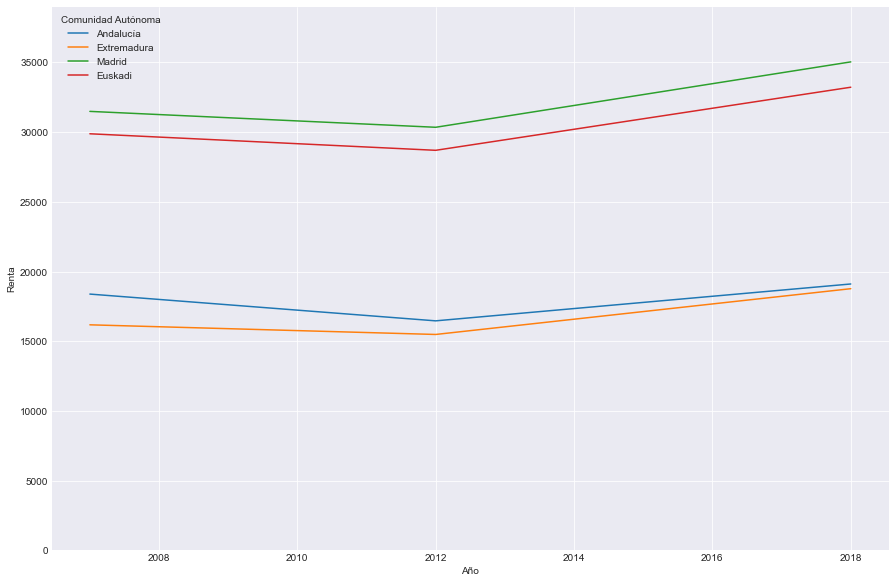

In [54]:
plt.figure(figsize=(15,10))
sns.lineplot(data = result,
            x = 'Año',
            y = 'Renta',
            hue = 'Comunidad Autónoma');  

plt.ylim(0, 39000)


In [55]:
# Quiero ver de qué fallecen principalmente en cada CCAA

Text(0, 0.5, 'Decesos')

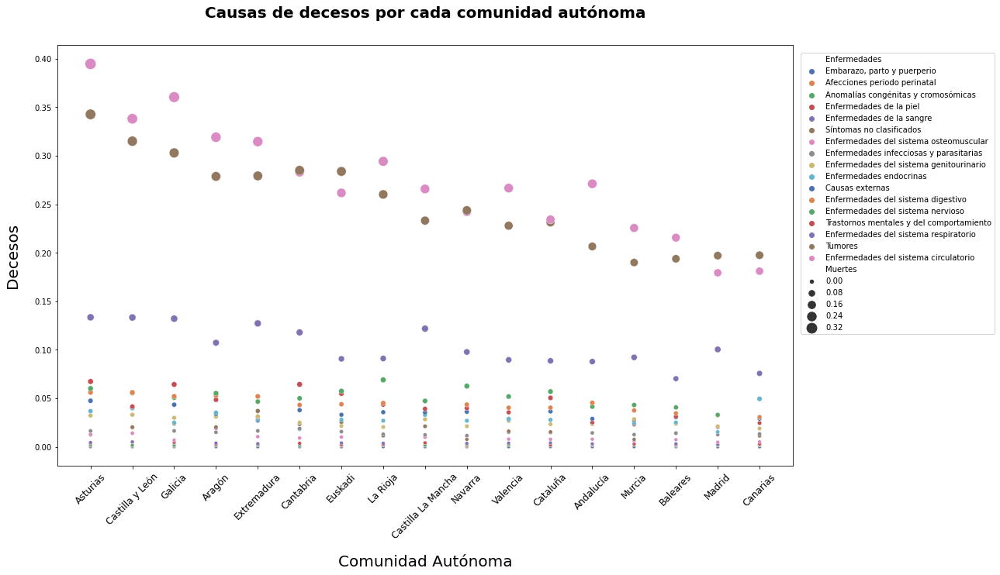

In [48]:
fig = plt.figure(figsize=(17, 10))
ax = fig.add_subplot(111)

deaths = sns.scatterplot(data=testing, x="Comunidad Autónoma", y="Muertes", hue="Enfermedades",
                         palette="deep", size = 'Muertes', sizes=(20, 200), legend = 'brief')

plt.xticks(rotation=45, size = 12)
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=1.)

ax.set_title('Causas de decesos por cada comunidad autónoma', size= 20, pad = 35, fontweight='bold') # negrita
ax.set_xlabel('Comunidad Autónoma', size = 20, labelpad = 18)   # 'labelpad' para alejar el texto de los ejes
ax.set_ylabel('Decesos', size = 20, labelpad = 18)

# Aquí se ve en qué proporción es responsable cada una de las enfermedades con respecto al % total de decesos
# en cada CCAA. Vemos, siguiendo la tendencia de gráficos anteriores, que tumores y circulatorio son los mayores.

# Si sumamos 0.0040 + 0.0035... nos sale el 0,012 del % total de decesos de Asturias

In [49]:
# Para guardar en archivo el gráfico

deaths.figure.savefig('svm_conf.png', dpi=400, bbox_inches="tight")


In [ ]:
# comparar Madrid y Extremadura, mayor y menor renta
# mapa skills fútbol con renta, inversión, tasa pobreza, decesos...

In [ ]:
# 2 ejes Y gráfico

In [58]:
tierrina = data_bonus[data_bonus['Comunidad Autónoma'] == 'Extremadura']

In [59]:
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=tierrina['Año'], y=tierrina['Renta'], name="Renta per cápita"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=tierrina['Año'], y=tierrina['Tasa pobreza'], name="Tasa pobreza"),
    secondary_y=True,
)

# Add figure title
fig.update_layout(
    title_text="Renta per cápita vs Tasa pobreza"
)

# Set x-axis title
fig.update_xaxes(title_text="Evolución histórica")

# Set y-axes titles
fig.update_yaxes(title_text="<b>primary</b> Renta per cápita", secondary_y=False)
fig.update_yaxes(title_text="<b>secondary</b> Tasa pobreza", secondary_y=True)

fig.show()

In [60]:
españa = data_bonus[data_bonus['Comunidad Autónoma'] == 'NACIONAL']

# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=españa['Año'], y=españa['Tumores'], name="Tumores"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=españa['Año'], y=españa['Enfermedades del sistema circulatorio'], name="Enf sistema circulatorio"),
    secondary_y=True,
)

# Add figure title

fig.update_layout(
    title={
        'text': "Tumores vs Enf sistema circulatorio",
        'y':0.95,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'})

# Set x-axis title
fig.update_xaxes(title_text="Evolución histórica")

# Set y-axes titles
fig.update_yaxes(title_text="<b>primary</b> Tumores", secondary_y=False)
fig.update_yaxes(title_text="<b>secondary</b> Enf sistema circulatorio", secondary_y=True)

fig.show()

In [50]:
data_total_mean

,Comunidad Autónoma,ID,Todas las causas,Enfermedades infecciosas y parasitarias,Tumores,Enfermedades de la sangre,Enfermedades endocrinas,Trastornos mentales y del comportamiento,Enfermedades del sistema nervioso,Enfermedades del sistema circulatorio,...,"Embarazo, parto y puerperio",Afecciones periodo perinatal,Anomalías congénitas y cromosómicas,Síntomas no clasificados,Causas externas,Población,Renta,Inversión,Tasa pobreza,Médicos especialistas
0,Andalucía,1.0,0.812273,0.014386,0.206485,0.003064,0.025049,0.025121,0.041380,0.271083,...,0.000044,0.002202,0.002121,0.025120,0.028941,8.323917e+06,17555.583333,1102.412893,30.833333,1.526667
1,Aragón,2.0,1.026278,0.015071,0.278670,0.003888,0.035252,0.048542,0.055246,0.319047,...,0.000056,0.001537,0.001863,0.020314,0.033816,1.328750e+06,25451.833333,1342.230185,14.900000,2.173333
2,Asturias,3.0,1.224578,0.016375,0.342616,0.004452,0.036887,0.067344,0.060181,0.394594,...,0.000032,0.001387,0.002143,0.012396,0.047486,1.057500e+06,20995.000000,1441.580433,13.616667,2.200000
3,Baleares,4.0,0.709636,0.014184,0.193804,0.003079,0.025062,0.031296,0.040661,0.215561,...,0.000038,0.001897,0.001182,0.013913,0.030475,1.106917e+06,25131.333333,1154.909565,18.616667,1.887500
4,Canarias,5.0,0.676349,0.013331,0.197476,0.002684,0.049468,0.024584,0.030522,0.181022,...,0.000024,0.001583,0.001918,0.011317,0.028987,2.089750e+06,19764.000000,1297.630846,30.108333,1.759167
5,Cantabria,6.0,0.985545,0.018850,0.284932,0.003096,0.018065,0.064384,0.050029,0.283162,...,0.000029,0.001370,0.001470,0.023388,0.037857,5.840000e+05,21748.000000,1338.516239,16.466667,1.765833
6,Castilla La Mancha,8.0,0.906191,0.012357,0.233118,0.003999,0.032984,0.039179,0.047347,0.265742,...,0.000028,0.001415,0.001751,0.021177,0.035471,2.060833e+06,18562.833333,1281.138909,29.041667,1.818333
7,Castilla y León,7.0,1.120043,0.019919,0.314960,0.005102,0.040222,0.041540,0.055516,0.338086,...,0.000027,0.001181,0.001732,0.020293,0.039852,2.497167e+06,21848.333333,1342.799050,18.675000,1.859167
8,Cataluña,9.0,0.837043,0.014690,0.231342,0.004217,0.027853,0.050472,0.057003,0.234218,...,0.000033,0.001486,0.001703,0.015341,0.036534,7.429417e+06,27579.916667,1195.413118,14.375000,1.945833
9,Euskadi,16.0,0.936185,0.015702,0.283810,0.004040,0.028014,0.054844,0.057479,0.261687,...,0.000019,0.001398,0.001978,0.025583,0.033063,2.170083e+06,30129.583333,1599.581965,10.883333,2.024167


In [51]:
import folium
import os

In [54]:
# MAPA DE TOTAL DE DECESOS 

# leo el archivo '.geojson'
state_geo = os.path.join('data', 'provincias-espanolas.geojson')
 
# Initialize the map:
m = folium.Map(location=[43.1257958, -8], zoom_start=5) 

# add tile layers to the map
# con esto posibilito que luego en el mapa pueda elegir el 'tipo de vista'
tiles = ['stamenwatercolor','cartodbpositron','openstreetmap','stamenterrain']
for tile in tiles:
    folium.TileLayer(tile).add_to(m)
    
 
# Add the color for the chloropleth:
m.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Todas las causas'],
 key_on='feature.properties.ccaa',   # esto lo he encontrado dentro del 'geojson', viendo su estructura de datos
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por comunidad autonoma'
)
folium.LayerControl().add_to(m)

m


# ¿Está falleciendo más gente en el noroeste de España?

In [53]:
# con esto puedo hacer 4 mapas, uno por cada enfermedad en top 4 y ver cómo es la distribución de esa enf por CCAA

# no me está pintando algunas y creo que es porque tengo un nombre distinto
# vamos a probar


for i in range(len(data_total_mean['Comunidad Autónoma'])):
    
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Asturias':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Asturias, Principado de'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Madrid':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Comunidad de Madrid'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Valencia':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Comunitat Valenciana'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Euskadi':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'País Vasco'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Castilla La Mancha':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Castilla - La Mancha'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Murcia':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Región de Murcia'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'Navarra':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Comunidad Foral de Navarra'
        
    if data_total_mean['Comunidad Autónoma'].iloc[i] == 'La Rioja':
        data_total_mean['Comunidad Autónoma'].iloc[i] = 'Rioja, La'
        
    
        
        
        
        


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [55]:
# MAPA DE DECESOS POR TUMORES 

 
# Initialize the map:
t = folium.Map(location=[43.1257958, -8], zoom_start=5, tiles = 'cartodbpositron')  
 
# Add the color for the chloropleth:
t.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Tumores'],
 key_on='feature.properties.ccaa',
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por tumores'
)
folium.LayerControl().add_to(t)

t

In [56]:
# MAPA DE DECESOS POR ENFERMEDADES DEL SISTEMA CIRCULATORIO 

 
# Initialize the map:
sc = folium.Map(location=[43.1257958, -8], zoom_start=5, tiles = 'cartodbpositron')  
 
# Add the color for the chloropleth:
sc.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Enfermedades del sistema circulatorio'],
 key_on='feature.properties.ccaa',
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por enfermedades del sistema circulatorio'
)
folium.LayerControl().add_to(sc)

sc

In [57]:
# MAPA DE DECESOS POR ENFERMEDADES DEL SISTEMA RESPIRATORIO 

 
# Initialize the map:
sr = folium.Map(location=[43.1257958, -8], zoom_start=5, tiles = 'cartodbpositron')  
 
# Add the color for the chloropleth:
sr.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Enfermedades del sistema respiratorio'],
 key_on='feature.properties.ccaa',
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por enfermedades del sistema respiratorio'
)
folium.LayerControl().add_to(sr)

sr

In [58]:
# MAPA DE DECESOS POR ENFERMEDADES DEL SISTEMA NERVIOSO 

# Initialize the map:
sn = folium.Map(location=[43.1257958, -8], zoom_start=5, tiles = 'cartodbpositron')  
 
# Add the color for the chloropleth:
sn.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Enfermedades del sistema nervioso'],
 key_on='feature.properties.ccaa',
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por enfermedades del sistema nervioso'
)
folium.LayerControl().add_to(sn)

sn

In [59]:
# MAPA DE DECESOS POR ENFERMEDADES DEL SISTEMA DIGESTIVO 

# Initialize the map:
# le doy coordenadas para que se ubique aprox en España
sd = folium.Map(location=[43.1257958, -8], zoom_start=5)  

# add tile layers to the map
# con esto posibilito que luego en el mapa pueda elegir el 'tipo de vista'
tiles = ['stamenwatercolor','cartodbpositron','openstreetmap','stamenterrain']
for tile in tiles:
    folium.TileLayer(tile).add_to(sd)

 
# Add the color for the chloropleth:
sd.choropleth(
 geo_data=state_geo,
 name='choropleth',
 data=data_total_mean,
 columns=['Comunidad Autónoma', 'Enfermedades del sistema digestivo'],
 key_on='feature.properties.ccaa',
 fill_color='BuPu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Decesos por enfermedades del sistema digestivo'
)


# aquí le añado al mapa las capas de 'tiles' que he agregado arriba
folium.LayerControl().add_to(sd)

sd

In [21]:
# esto sería para guardar el mapa
sd.save('index.html')


In [75]:
# he intentado usar este tipo de mapa pero no he conseguido que me funcione como quiero
# tendría que añadirle datos para ubicar geográficamente mis datos
# no lee / reconoce "Comunidad Autónoma" como sí lo hace 'folium'


import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [76]:
from urllib.request import urlopen
import json
#with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    #counties = json.load(response)

import pandas as pd
#df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   #dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(data_total_mean, geojson=state_geo, locations='Comunidad Autónoma', color='Tumores',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           
                           labels={'Tumores':'Decesos por tumores'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()